In [1]:
import sys
import scvi
import scgen
import rpy2
import scib
import json
import anndata
import logging
import warnings
import scanorama
import pandas as pd
import scanpy as sc
import numpy as np
import seaborn as sb
import scrublet as scr
import doubletdetection
from sklearn import cluster
from anndata import AnnData
from gtfparse import read_gtf
from os import PathLike, fspath
import matplotlib.pyplot as plt
from matplotlib.pyplot import rcParams

Global seed set to 0
/Users/temitopeleke/miniforge3/envs/mathys_reproduce_arm64/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/Users/temitopeleke/miniforge3/envs/mathys_reproduce_arm64/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)
/Users/temitopeleke/miniforge3/envs/mathys_reproduce_arm64/lib/python3.10/site-packages/phenograph/cluster.py:13: DeprecationWarning: Please use `spmatrix` from the `scipy.sparse` name

In [2]:
def get_sys_dpi(width, height, diag):
    '''
    obtain dpi of system
    
    w: width in pixels (if unsure, go vist `whatismyscreenresolution.net`)
    h: height in pixels
    d: diagonal in inches
    '''
    w_inches = (diag**2/ (1 + height**2/width**2))**0.5
    return round(width/w_inches)

In [3]:
# # Ignore R warning messages
# #Note: this can be commented out to get more verbose R output
# rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# # Automatically convert rpy2 outputs to pandas dataframes
# pandas2ri.activate()
# anndata2ri.activate()
# %load_ext rpy2.ipython

warnings.filterwarnings("ignore", category=PendingDeprecationWarning)
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=FutureWarning)

rcParams['figure.dpi'] = get_sys_dpi(1512, 982, 14.125)
#rcParams['figure.figsize']=(4,4) #rescale figures

sc.settings.verbosity = 3
#sc.set_figure_params(dpi=200, dpi_save=300)
sc.logging.print_versions()



-----
anndata     0.8.0
scanpy      1.9.1
-----
OpenSSL                     22.0.0
PIL                         9.2.0
absl                        NA
adjustText                  NA
anndata2ri                  1.1
annoy                       NA
appnope                     0.1.2
asttokens                   NA
astunparse                  1.6.3
attr                        21.4.0
backcall                    0.2.0
beta_ufunc                  NA
binom_ufunc                 NA
boto3                       1.26.32
botocore                    1.29.32
bottleneck                  1.3.5
brotli                      NA
certifi                     2022.09.24
cffi                        1.15.1
chex                        0.1.5
cloudpickle                 2.2.0
colorama                    0.4.4
contextlib2                 NA
cryptography                38.0.1
cycler                      0.10.0
cython_runtime              NA
dask                        2022.11.0
dateutil                    2.8.2
debugpy    

## Table of contents:

  * <a href=#Reading>1. Reading in the data</a>
  * <a href=#Preprocessing>2. Pre-processing and visualization</a>
    * <a href=#QC>2.1 Quality Control</a>
    * <a href=#Normalization>2.2 Normalization</a> 
    * <a href=#HVG>2.3 Highly variable genes</a>
    * <a href=#Visualization>2.5 Visualization</a>

# 1. Reading in the data

### [Mathys et. al. 2019](https://doi.org/10.1038/s41586-019-1195-2) (Prefrontal Cortex)

Processed and unprocessed (fastq) data were obtained from [synapse.org](https://www.synapse.org/) under the Synapse ID [syn2580853](https://doi.org/10.7303/syn2580853).

We have used the `cellranger count` and `cellranger aggr` pipelines provided in CellRanger software (v.7.0.1) (10x Genomics) to re-process the fastq files and obtain count data. Fastq files were mapped to the prebuilt cellranger Human (GRCh38) 2020-A reference, as opposed to the hg38 genome (GRCh38.p5 (NCBI:GCA_000001405.20) used in the paper. Quantification was performed on each of the 48 samples independenly using the `cellranger count` pipeline and, subsequently, the  `cellranger aggr` pipeline was used to aggregate all libraries and equalize the read depth between libraries before data merging to generate a gene-count matrix. Default parameters were used in both runs as suggested in the manuscript.

In [4]:
# Opening summary JSON file
f = open("../data/raw/mathys_pfc_remapped_with_all_samples_using_v7/count/summary.json")
summary_info = json.load(f)

keys_frac_reads_kept = [key.split("_")[2] for key in summary_info.keys() if "frac_reads_kept" in key and "mathys" in key]
values_frac_reads_kept = [summary_info[key]*100 for key in summary_info.keys() if "frac_reads_kept" in key and "mathys" in key]
#values_sequence_saturation = [summary_info[key] for key in summary_info.keys() if "sequence_saturation" in key and "mathys" in key]
#q30_bases_in_RNA_read = [summary_info[key] for key in summary_info.keys() if "Q30" in key and "mathys" in key]

# obtain the fraction of reads kept post normalization and sequence saturation

df_frac_reads_kept = pd.DataFrame({"sample": keys_frac_reads_kept, 
                                  "frac_reads_kept": values_frac_reads_kept,
                                  #"sequence_saturation": values_sequence_saturation,
                                  #'frac_q30_bases_in_RNA_read': q30_bases_in_RNA_read
                                  })

Ultimately, we obtain a total of 70494 unique cells and 36601 genes, which deviate from the 80,660 processed nuclei reported in [Mathys et. al. 2019](https://doi.org/10.1038/s41586-019-1195-2). In particular, the initial dataset obtained by [Mathys et. al. 2019](https://doi.org/10.1038/s41586-019-1195-2) contained `80,660 cells`, with a median value of `1,496 total read counts over protein-coding genes`, whereas our aggregated data contains `70,494 cells` with `1,446 median read counts per cells including intronic genes`. Below, we note a key sources of variation that could have led to the difference.



|  Source      | Local      | [Mathys et. al. 2019](https://doi.org/10.1038/s41586-019-1195-2)  |
| ----------- | ----------- | ----------- |
| CellRanger Version   | v7.0.1       |  v2.0.0       | 
| Genome (version)    |  Human (GRCh38) 2020-A (2020-A)     |  hg38 genome (GRCh38.p5 (NCBI:GCA_000001405.20) 2015/09/22   | 
| Post-normalization read depth |  Low (8.7%)     |  Not reported   | 
| Introns Included |  Yes (default in cell ranger v7.0.1)    |  No (not available in cell ranger v2.0.0) (used custom pre-mRNA reference) | 

We also note that a number of samples have poor `Per base sequence quality`--referring to samples with less than 65% of bases in the RNA reads having a phred quality score of > 30 i,e `there are less than 65% of Q30 bases in the RNA read`. Low Q30 Base percentages could indicate sequencing issue such as sub-optimal loading concentration.

In [5]:
all_samples = list(df_frac_reads_kept['sample'])
good_samples = all_samples.copy()

In [6]:
# del df_frac_reads_kept, keys_frac_reads_kept, values_frac_reads_kept, values_sequence_saturation, summary_info, f

Load filtered data V7 (Local)

In [7]:
# adata_filtered = sc.read_10x_h5("../data/raw/mathys_pfc_remapped_with_all_samples_using_v7/count/filtered_feature_bc_matrix.h5")

# # adata_filtered = adata_filtered[adata_filtered.X.sum(axis=1)>=200]

# aggregation = pd.read_csv('../data/raw/mathys_pfc_remapped_with_all_samples_using_v7/aggregation.csv')

# aggregation['libraryid'] = aggregation['sample_id'].apply(lambda x: x.split('_')[-1])
# libraryids = list(aggregation.libraryid)
# adata_filtered.obs['libraryid'] = None


# for ind, val in enumerate(libraryids):
#     adata_filtered.obs.loc[adata_filtered.obs.index.str.endswith(f'-{ind+1}'), 'libraryid'] = val

Load filtered data V3 (Local)

In [8]:
# adata_filtered = sc.read_10x_h5("../data/raw/mathys_pfc_remapped_with_all_samples_using_v3/filtered_feature_bc_matrix.h5")

# # adata_filtered = adata_filtered[adata_filtered.X.sum(axis=1)>=200]

# aggregation = pd.read_csv('../data/raw/mathys_pfc_remapped_with_all_samples_using_v3/aggregation.csv')

# aggregation['libraryid'] = aggregation['library_id'].apply(lambda x: x.split('_')[-1])
# libraryids = list(aggregation.libraryid)
# adata_filtered.obs['libraryid'] = None


# for ind, val in enumerate(libraryids):
#     adata_filtered.obs.loc[adata_filtered.obs.index.str.endswith(f'-{ind+1}'), 'libraryid'] = val

Load filtered data V2 (Local)

In [9]:
# #adata_filtered = sc.read_10x_h5("../data/raw/mathys_pfc_remapped_with_all_samples_using_v2/outs/filtered_gene_bc_matrices_h5.h5")
# adata_filtered = sc.read_mtx("../data/raw/mathys_pfc_remapped_with_all_samples_using_v2/outs/raw_gene_bc_matrices_mex/GRCh38/matrix.mtx").T
# genes = pd.read_csv("../data/raw/mathys_pfc_remapped_with_all_samples_using_v2/outs/raw_gene_bc_matrices_mex/GRCh38/genes.tsv",
#                      sep="\t", header=None, names=['ENS', 'gene_name'])
# barcodes = pd.read_csv("../data/raw/mathys_pfc_remapped_with_all_samples_using_v2/outs/raw_gene_bc_matrices_mex/GRCh38/barcodes.tsv",
#                      sep="\t", header=None, names=['barcode'])

# adata_filtered.obs_names = barcodes['barcode'] 
# adata_filtered.var_names = genes['gene_name']                                  
                     
# aggregation = pd.read_csv('../data/raw/mathys_pfc_remapped_with_all_samples_using_v2/outs/aggregation_csv.csv')

# aggregation['libraryid'] = aggregation['library_id'].apply(lambda x: x.split('_')[-1])
# libraryids = list(aggregation.libraryid)
# adata_filtered.obs['libraryid'] = None


# for ind, val in enumerate(libraryids):
#     adata_filtered.obs.loc[adata_filtered.obs.index.str.endswith(f'-{ind+1}'), 'libraryid'] = val

# new = adata_filtered.obs.libraryid.str.split("-", n = 1, expand = True)
# adata_filtered.obs.libraryid = new[1]

# adata_filtered = adata_filtered[adata_filtered.X.sum(1)>=200]

Load filtered data (Mathys)

In [10]:
adata_filtered = sc.read_mtx("../data/raw/mathys_pfc_from_paper/notfiltered_count_matrix.mtx").T

obs_names = pd.read_csv("../data/raw/mathys_pfc_from_paper/notfiltered_column_metadata.txt", sep='\t')
obs_names.set_index('TAG', inplace=True)
obs_names.index.rename('index', inplace=True)
adata_filtered.obs = obs_names

gene_names = pd.read_csv("../data/raw/mathys_pfc_from_paper/notfiltered_gene_row_names.txt", sep='\t', header=None)
adata_filtered.var_names = gene_names[1]

sample_key = pd.read_csv("../data/raw/mathys_pfc_from_paper/snRNAseqPFC_BA10_Sample_key.csv")
id_mapping = pd.read_csv("../data/raw/mathys_pfc_from_paper/snRNAseqPFC_BA10_id_mapping.csv")

merged_key = id_mapping.merge(sample_key, how="outer", on='projid')
merged_key['libraryid'] = merged_key['fastq'].str.split('-').apply(lambda x: x[1].split("_")[0])
merged_key.drop_duplicates(subset='libraryid', keep='first', inplace=True)
merged_key.reset_index(inplace=True)
merged_key.drop('index', axis=1, inplace=True)

adata_filtered.obs[list(merged_key.columns)] = None

for val in merged_key['sample']:
    adata_filtered.obs.loc[adata_filtered.obs.index.str.endswith(f'.{val}'), list(merged_key.columns)] = merged_key[merged_key['sample']==val].values

del gene_names
del obs_names
del merged_key


In [11]:
# main epidemiological and pathological characteristics of the participants
epi_n_patho = pd.read_excel("../data/raw/mathys_pfc_from_paper/41586_2019_1195_MOESM3_ESM.xlsx", sheet_name=1)

# clinico-pathological variables.
clin_n_patho = pd.read_excel("../data/raw/mathys_pfc_from_paper/41586_2019_1195_MOESM5_ESM.xlsx", sheet_name=0)

# clinical, epidemiological and pathological metadata
metadata = epi_n_patho.merge(clin_n_patho, how="outer", on="Subject")

# ID mapping from Mathys
mapping = pd.read_csv("../data/raw/mathys_pfc_from_paper/snRNAseqPFC_BA10_id_mapping.csv", sep=",")
mapping['sampleid'] = mapping['fastq'].str.split('-').apply(lambda x: x[1].split("_")[0])

metadata = metadata.merge(mapping, how='outer', on='Subject').sort_values(by='sampleid')
metadata = metadata[metadata['sampleid'].isin(good_samples)]
metadata.drop_duplicates(subset='sampleid', inplace=True)
metadata.reset_index(inplace=True)
metadata.drop('index', axis=1, inplace=True)

sampleids = list(metadata.sampleid.unique())

In [12]:
adata_filtered.obs[list(metadata.columns)] = None
columns = list(metadata.columns) 

sid = metadata.sampleid.astype(int).min()

for ind, val in enumerate(sampleids):
    adata_filtered.obs.loc[adata_filtered.obs.libraryid==val, columns] = metadata[metadata['sampleid']==val].values

adata_filtered.obs = adata_filtered.obs.astype('category').copy()

In [13]:
adata_filtered.obs_names_make_unique()
adata_filtered.var_names_make_unique()

In [14]:
del epi_n_patho, clin_n_patho, metadata, mapping, sampleids, good_samples, all_samples

In [15]:
adata_filtered

AnnData object with n_obs × n_vars = 80660 × 18192
    obs: 'projid', 'fastq', 'Subject', 'sample', 'libraryid', 'study', 'age_death', 'educ', 'msex_x', 'gpath_x', 'amyloid_x', 'plaq_n_x', 'cogdx_x', 'pathologic diagnosis of AD', 'amyloid_y', 'plaq_n_y', 'nft', 'tangles', 'cogn_global_lv', 'gpath_y', 'gpath_3neocort', 'amyloid.group', 'caa_4gp', 'ceradsc', 'braaksc', 'niareagansc', 'cogdx_y', 'msex_y', 'pathology.group', 'sampleid'

# 2 Pre-processing and visualization

## 2.1 Quality control

Here, we perfrom both cell and gene QC. In order to assess the quality of a cell we observe the number of expressed genes and the fraction of counts that are mitochondrial, whereas gene quality is assessed by cell count i.e detection in small or large number of cells.  `A high fraction of mitochondrial reads being picked up can indicate cell stress, as there is a low proportion of nuclear mRNA in the cell`. The high proportions of mitochondrial genes, indicative of poor-quality cells [(Lun, McCarthy & Marioni, 2017)](https://master.bioconductor.org/packages/release/workflows/html/simpleSingleCell.html#examining-gene-level-metrics), could also likley occur as a result of loss of cytoplasmic RNA from perforated cells. Since mitochondria are larger than individual transcript molecules and less likely to escape through tears in the cell membrane. It should be noted that high mitochondrial RNA fractions can also be biological signals indicating elevated respiration. 

To assemble some of the information/metrics for quality control, we employ the `pp.calculate_qc_metrics`, in `scanpy`.


##### Obtain QC metrics

First, guided by the cell and gene quality control measures implemented by [Mathys et. al. 2019](https://doi.org/10.1038/s41586-019-1195-2), we quantify the following quality measures for cell inclusion; 

* The number of genes for which at least one read was mapped (which is indicative of library complexity); `.var key = n_genes_by_counts`
* The total number of counts; `.obs key = total_counts`
* The percentage of counts mapping to the top 50 genes; `.obs key = pct_counts_in_top_50_genes`
* The percentage of reads mapped to mitochondrial genes (which may be used to approximate the relative amount of endogenous RNA, and is commonly used as a measure of cell quality).  `.obs key = pct_counts_mt`

In [16]:
def obtain_qc_metrics(adata: AnnData, prefix: str='MT-'):
    
    print(f'Estimating QC metrics...')
    adata.var['mt'] = adata.var_names.str.startswith(prefix)  # annotate the group of mitochondrial genes as 'mt'
    sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=[50], log1p=False, inplace=True)
    return adata

In [17]:
adata_filtered = obtain_qc_metrics(adata_filtered, prefix='MT-')

Estimating QC metrics...


##### QC Violin Plot

Next, we visualize the cell density as a function of function of these metrics to see whether there are cells with unusual quality scores such as high `pct_counts_mt` or low `n_genes_by_counts`.

To do this, we use a violin plot of the computed quality measures:

* The number of genes expressed in the count matrix
* The total counts per cell
* The percentage of counts in mitochondrial genes
* The percentage of genes in the top 50 genes 

Plotting QC metrics...


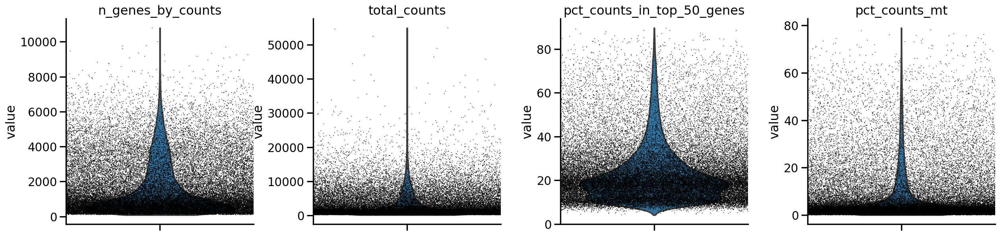

In [18]:
print(f'Plotting QC metrics...')
sc.pl.violin(adata_filtered, ['n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_mt'],
    jitter=0.9, multi_panel=True)

#### Basic Filtering

The plots show that the `mathys_pfc` data indeed has sufficient cell and gene quality, as the counts per cell, numbder of detected genes, fraction of counts mapped to the top 50 genes are densely distributed with a significant number of cells low `pct_counts_mt` where the fraction of mitochondrial reads are below `20%`. We subsequently note this `pct_counts_mt` dirstribution as a potential filtering thresholf for downstream analysis.

However, erforming filtering of low quality cells using the `pct_counts_mt` covariate in isolation can lead to misinterpretation of the underlying cellular information. To avoid this, we jointly consider the covariates using the following plots.

In [19]:
fig, axs = plt.subplots(1, 1, figsize=(6, 4))
sc.pl.scatter(adata_filtered, 'total_counts', 'n_genes_by_counts', color='pct_counts_mt', ax=axs, show=False, frameon=False)

<AxesSubplot:title={'center':'pct counts mt'}, xlabel='total_counts', ylabel='n_genes_by_counts'>

In [20]:
fig, axs = plt.subplots(1, 1, figsize=(6, 4))
sc.pl.scatter(adata_filtered, 'total_counts', 'n_genes_by_counts', color='pct_counts_in_top_50_genes', ax=axs, show=False, frameon=False)


<AxesSubplot:title={'center':'pct counts in top 50 genes'}, xlabel='total_counts', ylabel='n_genes_by_counts'>

From the plots above, we can see that there are only a handful of cells with unexpected summary statistics. For example, there's a low density of cells with high total counts and number of detected genes. These cells also have very low fraction of mitochondrial genes detected, and may contain useful information. In contrast, we obtain a high density of cells with low total number of counts and detected genes. These cells also also very high fraction of reads mapped to mitochondrial genes. 

[Mathys et. al. 2019](https://doi.org/10.1038/s41586-019-1195-2) chose a cut-off value of 200 detected genes and abnormally high ratio of counts mapping to mitochondrial genes was used to select single cells for further analysis. They determined this cut-off value by projecting the the entire dataset onto the two-dimensional space using `t-distributed stochastic neighbour embedding (t-SNE)` on the top 10 principal components. The t-SNE coordinates were used to visualize potential outliers and cell clusters with good quality measures they also plotted a histogram showing cell density as a function of total counts. On the basis of this analysis they determined 200 UMIs as the lower cut-off for cell filtering.

Thus, we visualize the data on a two-dimensional graph using the t-SNE method. Here, we note that we do not scale the genes to have zero mean and unit variance as this retains the relative expression in the dimensionality reduction such that genes with a higher mean expression have a higher weight in dimensionality reduction (despite correcting for mean offsets in PCA, due to the mean-variance relationship). This is crucial since this weighting is liley a biologically relevant signal for the filtering step.




In [21]:
# first perform pca dim reduction to reveal the main axes of variation and denoise the data.
sc.pp.pca(adata_filtered)

# compute neighborhood graph of cells using PCA representation 
sc.pp.neighbors(adata_filtered, n_pcs=10)

# embed the graph in two dimensions using TSNE
# - Shows several distinct clusters with clear subcluster structure
# - Connections between clusters are difficult to interpret visually

sc.tl.tsne(adata_filtered, n_jobs=12) #Note n_jobs works for MulticoreTSNE, but not regular implementation)


computing PCA
    with n_comps=50
    finished (0:02:13)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:53)
computing tSNE
    using 'X_pca' with n_pcs = 50
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:28:35)


##### Pre-QC Visualization

/Users/temitopeleke/miniforge3/envs/mathys_reproduce_arm64/lib/python3.10/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/Users/temitopeleke/miniforge3/envs/mathys_reproduce_arm64/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:452: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  pl.colorbar(


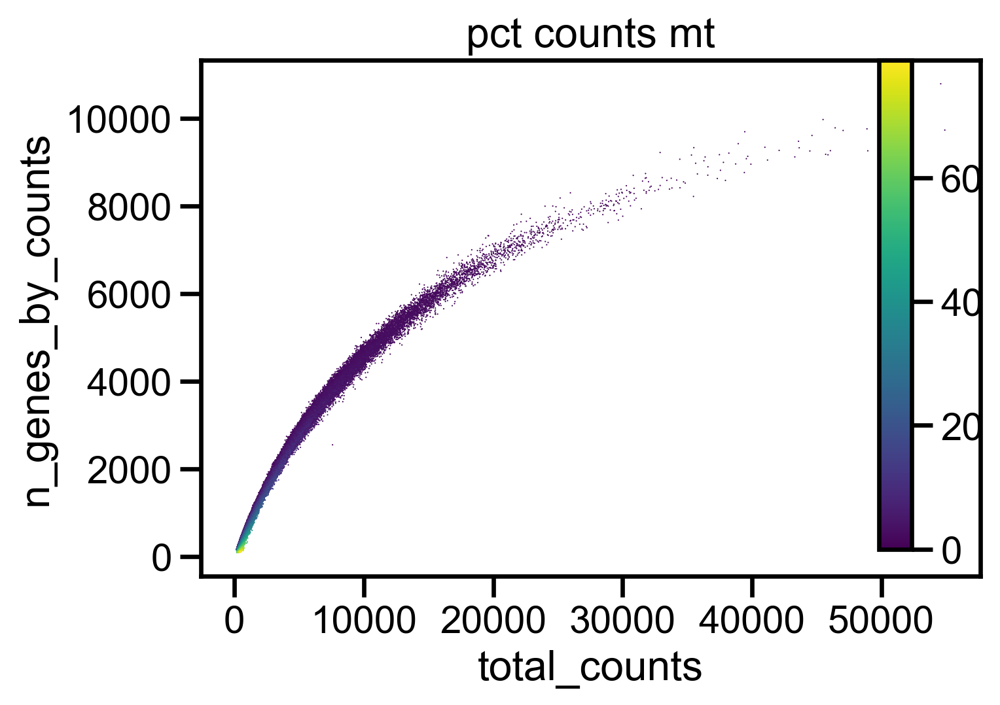

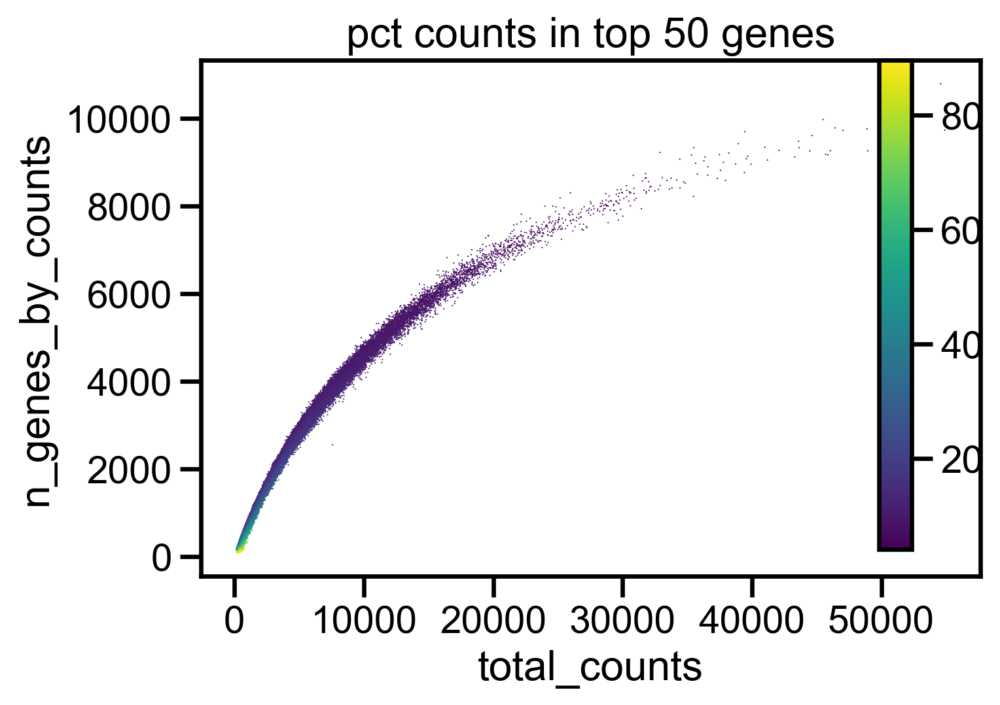

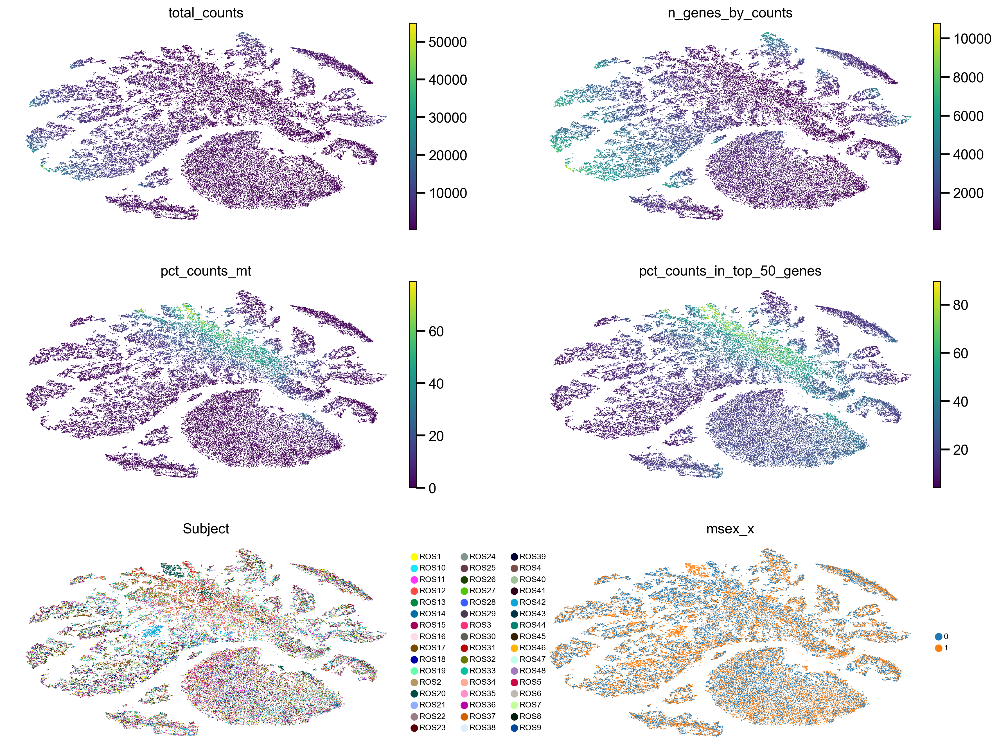

In [22]:
sc.set_figure_params(scanpy=True, dpi=rcParams['figure.dpi'],
                    dpi_save=150, frameon=False, 
                    vector_friendly=True, fontsize=14, figsize=(7, 4), 
                    color_map=None, format='pdf', facecolor=None,
                     transparent=False, ipython_format='png2x')
                     
sc.pl.tsne(adata_filtered, color=['total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'pct_counts_in_top_50_genes', 'Subject', 'msex_x'], ncols=2,
         frameon=False, legend_fontsize='xx-small', wspace=0.2)


Surprisingly, the isolated clusters in the visalization do not express unsual quality measures, contrary to the report by [Mathys et. al. 2019](https://doi.org/10.1038/s41586-019-1195-2) that outlier cells in these quality metrics were found to cluster together in the t-SNE two-dimensional space. Interestingly, we find that cells with high mitochondrial genes also happen to have high fraction of counts mapping to top 50 genes, similar to the density plots shown above, suggesting that mitochondrial genes make up most of the genes in these cells. These are likely apoptotic cells since these cells also have lower total counts and number of detected genes. Apoptitic cells export mitochondrial genes to the cytoplasm, so when apoptotic reads mapped to mitochondria genes. [Malte D Luecken1 & Fabian J Theis](https://www.embopress.org/doi/full/10.15252/msb.20188746) 

To choose an appropriate filtering threshold for the cells with abnormally high ratio of counts mapping to mitochondrial genes, we draw upon a recent systematic survey of scRNA-seq data which suggested that a mitochondrial proportion threshold of 10% is appropriate to distinguish between healthy and low-quality cells in most human tissues, while in mouse tissues, the recommended threshold is 5% [Osorio D & Cai JJ](https://academic.oup.com/bioinformatics/article/37/7/963/5896986?login=false). 

Therefore, in addition to excluding cells with less than 200 genes detected, and genes detected in fewer than 2 cells, we exclude cells with `pct_counts_mito` > `10%`.

Importantly, we note that this population of mitochondrial genes are predominated by samples from male (`msex = 1`) participants. Therefore filtering might redudce the size effect of this population.

##### Cell and Gene Filtering

In [23]:
def basic_filter(adata: AnnData,
                min_genes: int = 200,
                min_cells: int = 2, 
                filter_mito: bool = True,
                mito_threshold: float = 15,
                mito_obs_key: str = 'pct_counts_mt',
                use_kmeans:str = False):
                
    sc.pp.filter_cells(adata, min_genes=min_genes)
    sc.pp.filter_genes(adata, min_cells=min_cells)

    if filter_mito:
        if use_kmeans:
            kmeans = cluster.KMeans(n_clusters=2, random_state=0, n_init="auto").fit(adata.obs[mito_obs_key])
            adata.obs['is_high_mito'] = kmeans.labels_
            print(f'filtered out {len(adata[adata.obs["is_high_mito"] == 1])} cells that cluster with high mitochondria genes')
            adata = adata[adata.obs["is_high_mito"] == 1].copy()
        else:
            print(f'filtered out {len(adata[adata.obs[mito_obs_key] > mito_threshold])} cells that have more than 10% mitochondria genes')
            adata = adata[adata.obs[mito_obs_key] <= mito_threshold].copy()

    return adata

In [24]:
adata_filtered = basic_filter(adata_filtered)

filtered out 4434 cells that have less than 200 genes expressed
filtered out 247 genes that are detected in less than 2 cells
filtered out 9677 cells that have more than 10% mitochondria genes


##### POST-QC Visualization

/Users/temitopeleke/miniforge3/envs/mathys_reproduce_arm64/lib/python3.10/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/Users/temitopeleke/miniforge3/envs/mathys_reproduce_arm64/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:452: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  pl.colorbar(


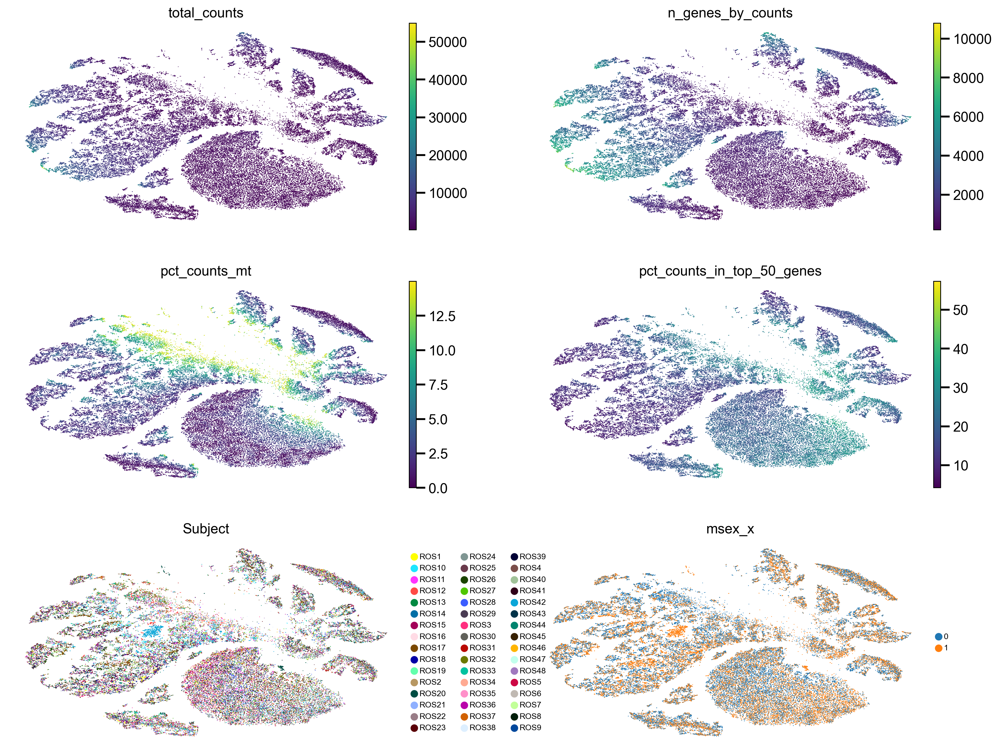

In [25]:
sc.set_figure_params(scanpy=True, dpi=rcParams['figure.dpi'],
                    dpi_save=150, frameon=False, 
                    vector_friendly=True, fontsize=14, figsize=(7, 4), 
                    color_map=None, format='pdf', facecolor=None,
                     transparent=False, ipython_format='png2x')
                     
sc.pl.tsne(adata_filtered, color=['total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'pct_counts_in_top_50_genes', 'Subject', 'msex_x'], ncols=2,
         frameon=False, legend_fontsize='xx-small', wspace=0.2)

From the above diagram, it is apparent that certain cells still have unusual distributions, these cells are likely doublets or multiplets. Cells with very few expressed features or small library size indicate low RNA-capture efficiency and are hence considered poor quality. On the other hand, cells with abnormally a large number of expressed features suggest doublets or multiplets.

Therefore we estimate the doublets/multiplets present in each data before further filtering is performed. To do this, we use the `Scrublet` and `DoubletDetection` doublet prediction python packages which have been shown to demonstrate strong performance compared with the other doublet detection methods and particularly achieved top performance in removing spurious cell clusters, homotypic doublets, and inferred trajectories that most resembled the trajectory inferred from the clean data.

Although functionality for assessing `DoubletDetection` predictions is provided below, we stick with results from `Srublet` since it is approximately `4 times faster` than `DoubletDetection`.

#### Scrublet


**Description**

Taken from [Samuel L. Wolock 2019](https://doi.org/10.1016/j.cels.2018.11.005)

`scr.scrub_doublets() simulates doublets from the observed data and uses a k-nearest-neighbor classifier to calculate a continuous doublet_score (between 0 and 1) for each transcriptome. The score is automatically thresholded to generate predicted_doublets, a boolean array that is True for predicted doublets and False otherwise.`

**Relevant parameters**

`expected_doublet_rate`: the expected fraction of transcriptomes that are doublets, typically 0.05-0.1. Results are not particularly sensitive to this parameter. For this example, the expected doublet rate comes from the Chromium User Guide: https://support.10xgenomics.com/permalink/3vzDu3zQjY0o2AqkkkI4CC

`sim_doublet_ratio`: the number of doublets to simulate, relative to the number of observed transcriptomes. This should be high enough that all doublet states are well-represented by simulated doublets. Setting it too high is computationally expensive. The default value is 2, though values as low as 0.5 give very similar results for the datasets that have been tested.

`n_neighbors`: Number of neighbors used to construct the KNN classifier of observed transcriptomes and simulated doublets. The default value of round(0.5*sqrt(n_cells)) generally works well.


Running Scrublet
filtered out 135 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    Scrublet finished (0:01:57)


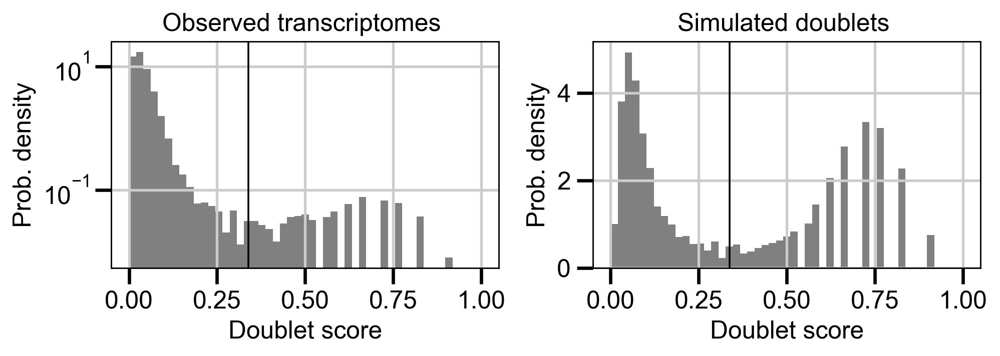

In [26]:
sc.external.pp.scrublet(adata_filtered, sim_doublet_ratio=2.0, 
                        expected_doublet_rate=0.05, stdev_doublet_rate=0.02,
                        knn_dist_metric='euclidean', n_prin_comps=30, get_doublet_neighbor_parents=True,
                        n_neighbors=None, threshold=None, verbose=False, random_state=0)

sc.external.pl.scrublet_score_distribution(adata_filtered, scale_hist_obs='log',
                                           scale_hist_sim='linear', figsize=(8, 3),
                                           return_fig=False, show=True, save=None)

adata_filtered.obs['predicted_doublet'] = adata_filtered.obs['predicted_doublet'].astype(str)
adata_filtered.uns['scrublet']['doublet_neighbor_parents'] = adata_filtered.uns['scrublet']['doublet_neighbor_parents'].tolist()

##### DoubletDetection

In [27]:

# for key in adata_query.keys():
#     print("=========================================================")
#     print(f'Estimating doublets on {key} data using DoubletDetection')

#     clf = doubletdetection.BoostClassifier(n_iters=10, clustering_algorithm="louvain",
#                                            standard_scaling=True, pseudocount=0.1, n_jobs=-1,)
#     doublets = clf.fit(adata_query[key].X).predict(p_thresh=1e-16, voter_thresh=0.5)
#     doublet_score = clf.doublet_score()

#     adata_query[key].obs["dd_doublet"] = doublets
#     adata_query[key].obs["dd_doublet_score"] = doublet_score

#     print('\n')

We now joinly consider the estimated doublet scores together with the QC metrics previously computed.

To do this, we visualize and subsequently filter low quality and doublet cells by simultaneously filtering cells that meet quality (`reasonably high gene and total counts`, and `low doublet scores`)

##### Filter Doublets

In this data, we filter low quality and doublet cells by simultaneously filtering cells that meet quality (`low mitochondrial count`, `reasonably high gene and total counts`, and `low doublet scores`)

/Users/temitopeleke/miniforge3/envs/mathys_reproduce_arm64/lib/python3.10/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/Users/temitopeleke/miniforge3/envs/mathys_reproduce_arm64/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:452: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  pl.colorbar(


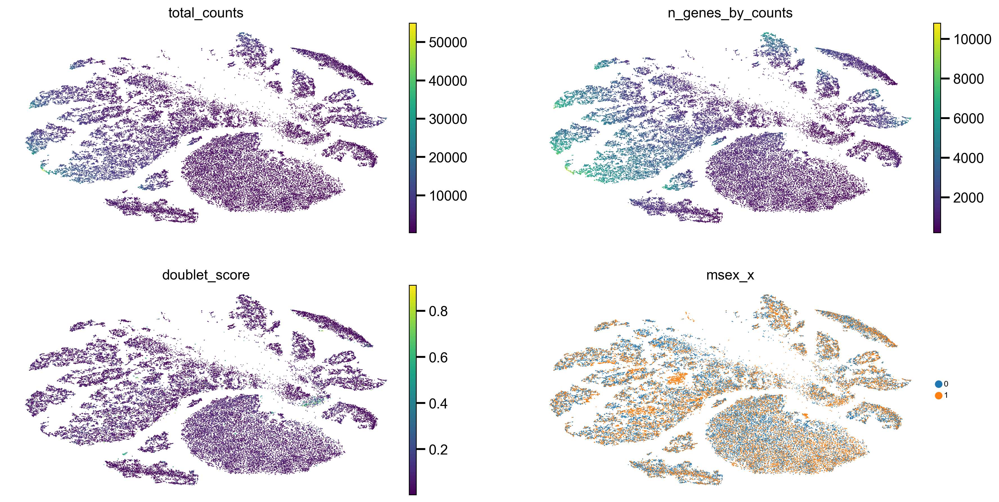

In [28]:
sc.set_figure_params(scanpy=True, dpi=rcParams['figure.dpi'],
                    dpi_save=150, frameon=False, 
                    vector_friendly=True, fontsize=14, figsize=(7, 4), 
                    color_map=None, format='pdf', facecolor=None,
                     transparent=False, ipython_format='png2x')
                     
sc.pl.tsne(adata_filtered, color=['total_counts', 'n_genes_by_counts', 'doublet_score', 'msex_x'], ncols=2,
         frameon=False, legend_fontsize='xx-small', wspace=0.2)

From the plots above, the plots above, it appears that no cluster is predominated by detected doublets. Therefore we only note the predicted doublets at this stage, keeping them for further downstream analysis.

#### Include Only Protein-Coding Genes

In [29]:
gene_features = read_gtf("../data/raw/Gene_Features_GRCh38.p14_genomic.gtf")
protein_coding_genes = gene_features[gene_features['gene_biotype']=='protein_coding']['gene_id'].to_list()
adata_filtered = adata_filtered[:, adata_filtered.var_names.isin(protein_coding_genes)]

del gene_features, protein_coding_genes

## 2.2 Normalization

Up to this point the data is only available as a count matrix. The total number of counts identified varies between cells because not all of the mRNA molecules in each cell are captured. This variation is likely due to both the sampling method and the number of molecules present in each cell. To capture the technical and hopefully biological variation that exists in the scRNA-seq data, we normalize, that is, scale the raw count data to obtain relative abundance profiles of cells in each sample. This will also help to resolve factors/covariates like `sequencing depth, capture efficiency, and cell composition` among others that could confound biological significance/interpretation of gene expression abundances. 

Several normalization methods which attempt to obtain a reliable estimates of a cell-specific `size_factor--an measure of the relative abundance of molecules originally contained in each cell--`for normalization have been developed. These methods include `pooling-based` method in `scran (R package)` whihc has been shown to effectively remove confounding technical effects and improve differential gene expression analysis. This method relies on a cell-based normalization approach which estimates a cell-specific but robust (global) `size_factor` (`proportional to the count depth per cell`) to normalize all the genes in the same cell and while effectively avoiding the impact of excessive zero counts that typically arise due to sampling and the `scanpy` implemented `normalize_total` strategy, a scaling normalization method which corrects for count depth effects by dividing the feature-level read counts by the library size (i.e., total read counts within each sample) and multiplying a constant value (e.g., 10,000), among several others. Several studies report that the method in `scran (R package)` performs the best [Beathe Vieth, 2019, Buettner et al., 2019]. 

However, [Mathys et. al. 2019](https://doi.org/10.1038/s41586-019-1195-2) used the  `scanpy` implemented `normalize_total` method, a strategy where counts for all nuclei were scaled by the total library size multiplied by 10,000, and transformed to log space. We note that this strategy is likely to bias towards highly expressed transcripts and susceptible to zero inflated feature-level read counts. To mitigate these, its is reasonable to exclude genes that account for at least 5% of the total counts to allow for molecular count variability among a few highly expressed genes. 

To implement this one can set;

* `target_sum` = `10000`
* `exclude_highly_expressed` = `True`, 
* `max_fraction` = `0.05` 

As a result, very highly expressed genes are excluded from the computation of the normalization factor (size factor) for each cell. This is meaningful as these can strongly influence the resulting normalized values for all other genes. A gene is considered highly expressed, if it has more than `max_fraction` of the total counts in at least one cell. The not-excluded genes will sum up to `target_sum`.

After normalization, we typically log transform the data using $$log(x + 1)$$ This is important since the log-transfromed expression values will represent log fold changes, a canonical way to measure changes in expression. Also, it mitigates the skewness of the data to which many downstream analysis methods rely on. 

However, since [Mathys et. al. 2019](https://doi.org/10.1038/s41586-019-1195-2) report using log-transformed data only after highly variable genes were selected, we take the same approach here. 

In [30]:
def normalize_data(adata: AnnData, 
                   target_sum: int = 1e04,
                   exclude_highly_expressed: bool = True,
                   max_fraction: float = 0.05, 
                   ):

    # Keep the count data in a counts layer and normalize
    adata.layers["counts"] = adata.X.copy()
    sc.pp.normalize_total(adata, target_sum, exclude_highly_expressed, max_fraction)
    # store normalized data in layer
    adata.layers['norm'] = adata.X.copy()
    # log-transform normalized data
    
    sc.pp.log1p(adata)

    # Store the full data set in 'raw' as log-normalised data for statistical testing
    adata.raw = adata

    return adata

In [31]:
adata_filtered = normalize_data(adata_filtered, target_sum=1e04, exclude_highly_expressed=False)

normalizing counts per cell
    finished (0:00:00)


## 2.3 Highly Variable Genes

We extract highly variable genes (HVGs) to further provide optionality to reduce the dimensionality of the dataset and include only the most informative genes. Genes that vary substantially across the dataset are informative of the underlying biological variation in the data. As we only want to capture biological variation in these genes, we estimate highly variable genes after normalization. We also employ these HVGs for downstream analysis like `clustering`, `trajectory inference`, and d`imensionality reduction/visualization`, `while the full data set is used for computing marker genes`, `differential testing`, `cell cycle scoring`, and `visualizing expression values` on the data.

Here we use a standard technique for the extraction of highly variable genes provided in `scanpy` from the 10X genomics preprocessing software CellRanger. In [**Hansruedi Mathys et. al.**](https://doi.org/10.1038/s41586-019-1195-2), a total of `3188` HVGs were identified. 

To do this, [**Hansruedi Mathys et. al.**](https://doi.org/10.1038/s41586-019-1195-2) use the `scanpy 1.3.6` function `highly_variable_genes`, which annotates highly variable genes bases on their mean and dispersion. This function requires logarithimized data. After detecting the informative genes, the authors report logarithimizing the data using `log1p` as discribed above and subsequently regressing out technical effect of the total number of counts using `regress_out`.

Downstream analysis are typically known to be sensitive to preprocessing steps like `scaling` (where genes have zero mean and unit variance). Lack of rescaling is equivalent to giving genes with a higher mean expression a higher weight in dimensionality reduction and [**Malte D Luecken & Fabian J Theis**](https://www.embopress.org/doi/full/10.15252/msb.20188746) argue that this weighting based on mean expression is a biologically relevant signal. Indeed, `scaling` has been shown to lead scRNA-seq integration methods to prioritize removal of technical covariates over bio-conservation during harmonization of multiple studies [Luecken et. al. 2019](https://doi.org/10.1038/s41592-021-01336-8). On the other hand, rescaling HVG expression is also common, and the number of publications that use this approach suggests that scaling is at least not detrimental to downstream scRNA-seq analysis. However, [**Malte D Luecken & Fabian J Theis**](https://www.embopress.org/doi/full/10.15252/msb.20188746) note that there is currently no consensus on whether scaling over genes is informative or retains much biological information about the data. 

In [32]:
def scale_anndata(adata):

    X = adata.X.copy()

    axis = 0
    mean = np.mean(X, axis=axis, dtype=np.float64)
    mean_sq = np.multiply(X, X).mean(axis=axis, dtype=np.float64)
    var = mean_sq - mean**2

    # enforce R convention (unbiased estimator) for variance
    var *= X.shape[axis] / (X.shape[axis] - 1)

    std = np.sqrt(var)
    X -= mean
    X /= std

    adata.X = X
    adata.var['mean'] = mean
    adata.var['std'] = std

    del X, mean, var, mean_sq, std
    
    return None

In [33]:

def get_HVGs(adata: AnnData,
            flavor: str='seurat', # flavor for computing normalized dispersion. use‘seurat’ for non-logarithmized data.
            min_mean: int=None,
            max_mean: int=None,
            min_disp: int=None,
            max_disp: int=None, 
            subset: bool=False,  # Keep only highly-variable genes       
            n_top_genes: int=None, # Number of highly-variable genes to keep.
            viz_mean_var_rel: bool=True):

    # deprecated
    # specify flavor in .uns

    # adata.uns['hvg'] = {'flavor': 'seurat'}
    # sc.pp.filter_genes_dispersion(adata, flavor, min_mean, max_mean, min_disp, max_disp, n_top_genes, subset)
    # dispersion_norm = adata.var['dispersions_norm'].values.astype('float32')
    
    # if n_top_genes is not None:
    #     dispersion_norm = dispersion_norm[~np.isnan(dispersion_norm)]
    #     dispersion_norm[::-1].sort()  # interestingly, np.argpartition is slightly slower
    #     disp_cut_off = dispersion_norm[n_top_genes - 1]
    #     gene_subset = adata.var['dispersions_norm'].values >= disp_cut_off
    # else:
    #     if min_disp is None:
    #         min_disp = 0.5
    #     if min_mean is None:
    #         min_mean = 0.0125
    #     if max_mean is None:
    #         max_mean = 3
    #     mean = adata.var.means
    #     max_disp = np.inf if max_disp is None else max_disp
    #     dispersion_norm[np.isnan(dispersion_norm)] = 0  # similar to Seurat
    #     gene_subset = np.logical_and.reduce((mean > min_mean, mean < max_mean,
    #                                         dispersion_norm > min_disp,
    #                                         dispersion_norm < max_disp,))

    
    # adata.var['gene_subset'] = gene_subset
    # adata.var['highly_variable'] = gene_subset

    # print(f'Detected {adata.var.highly_variable.sum()} genes')

    # del mean, max_disp, dispersion_norm, gene_subset
    
    # if viz_mean_var_rel:
    #      sc.pl.filter_genes_dispersion(adata)

    # log-transform normalized data
    # sc.pp.log1p(adata)

    sc.pp.highly_variable_genes(adata, min_mean=0.0125 , max_mean=3 , min_disp=0.5)
    
    # regress out  technical influence of the total number of counts
    sc.pp.regress_out(adata, keys=['total_counts'])

    # Keep the log-normalized data in layer and scale
    adata.layers['log'] = adata.X.copy()

    # scale logarithmized data to unit variance and zero mean
    sc.pp.scale(adata, max_value=10)

    #or alternatively scale with scale_anndata(adata)

    # Store the full data set in 'raw' as log-normalised data for statistical testing
    adata.raw = adata
    
    return adata

In [34]:
adata_filtered = get_HVGs(adata_filtered, flavor='seurat', viz_mean_var_rel=True)

extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
regressing out ['total_counts']
    sparse input is densified and may lead to high memory use
    finished (0:14:06)


In [35]:
print(f"There are {sum(adata_filtered.var.highly_variable)} HVGs")

There are 3195 HVGs


## 2.4 Clustering

Next, we project the high-dimensional matrix of cells and genes into a few coordinates such that every cell is meaningfully represented in a two-dimensional graph. There are seeveral methods of dimensionality reduction, and each method uniquely defines and represents particular aspect of the data. We have summarized the major methods and their characteristics below as described by [**Malte D Luecken & Fabian J Theis**](https://www.embopress.org/doi/full/10.15252/msb.20188746).

PCA:
- Typically, first principle component captures variation in count depth between cells, and is only marginally informative

t-SNE:
- Shows several distinct clusters with clear subcluster structure
- Connections between clusters are difficult to interpret visually

UMAP:
- Data points are spread out on the plot showing several clusters
- Connections between clusters can be readily identified

Diffusion Maps:
- Shows connections between regions of higher density
- Very clear trajectories are suggested, but clusters are less clear
- Each diffusion component extracts heterogeneity in a different part of the data

Graph:
- Shows a central cluster and several outer clusters
- Shows clear connections from the central cluster (likely stem cells) to outer clusters

The authors performed principal component analysis (PCA) on the detected variable genes. We have identified `3,195` hvgs compared to the reported `3188`. t-SNE was run on the top `10 principal components (PCs)` using the `Multicore-TSNE package` (https://github.com/DmitryUlyanov/Multicore-TSNE), a python package automatically detected by `scanpy` (note that support for `MultiTSNE` will be deprecated in future versions of scanpy).

Next, the top `50 PCs`, which were shown to capture 100% of the variance,were used to build a k-nearest-neighbours cell–cell graph with k = 30 neighbours (to capture local and long-range structure); subsequently spectral decomposition over the graph was performed with `15 components`, and the Louvain graph-clustering algorithm was applied to identify cell clusters.

These analyses were performed using the functions `sc.pp.pca`, `sc.pp.neighbours`, and `sc.tl.louvain`


In [36]:
def dim_red(adata: AnnData,
            use_hvgs: bool=True,
            svd_solver: str='arpack',
            n_neighbors: int=30,
            n_pcs_neigh: int=50,
            n_pcs_tsne: int=10,
            use_fast_tsne: bool=True,
            tsne_colors: list=['msex_x', 'braaksc', 'amyloid.group', 'pathology.group'],
            umap_colors: list=['msex_x', 'braaksc', 'amyloid.group', 'pathology.group'],
            tsne_wspace: float=0.25,
            umap_wspace: float=0.25,
            viz_expl_ratio: bool=True,
            viz_tsne: bool = True,
            viz_umap: bool=True):

    # first perform pca dim reduction to reveal the main axes of variation and denoise the data.
    sc.pp.pca(adata, use_highly_variable=use_hvgs, svd_solver=svd_solver)

    # plot explained variance ratio
    if viz_expl_ratio:
        print('Visualizing explained variance ratio...')
        sc.pl.pca_variance_ratio(adata, n_pcs=50)

    # compute neighborhood graph of cells using PCA representation 
    sc.pp.neighbors(adata, n_neighbors=n_neighbors, n_pcs=n_pcs_neigh)

    # embed the graph in two dimensions using tSNE.
    # tSNE shows distinct clusters with clear subcluster structure,
    # set use_fast_tsne=True to use Multicore-TSNE

    sc.tl.tsne(adata, n_pcs=n_pcs_tsne, use_fast_tsne=use_fast_tsne)
    if viz_tsne:
        print('Visualizing tSNE embedding...')
        sc.pl.tsne(adata, color=tsne_colors, ncols=2, wspace=tsne_wspace)

    # embed the graph in two dimensions using UMAP.
    # UMAP is potentially more faithful to the global connectivity of the manifold than tSNE,
    # i.e., it better preserves trajectories.

    sc.tl.umap(adata)
    if viz_umap:
        print('Visualizing UMAP embedding...')
        sc.pl.umap(adata, color=umap_colors, ncols=2, wspace=umap_wspace)

    return adata


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:11)
Visualizing explained variance ratio...


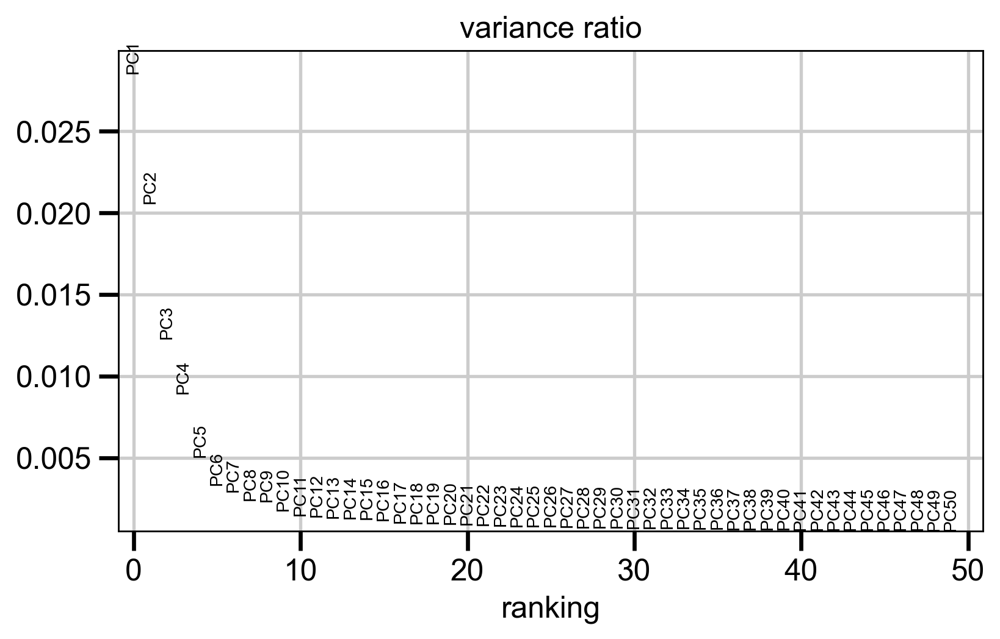

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:05)
computing tSNE
    using 'X_pca' with n_pcs = 10
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:02:55)
Visualizing tSNE embedding...


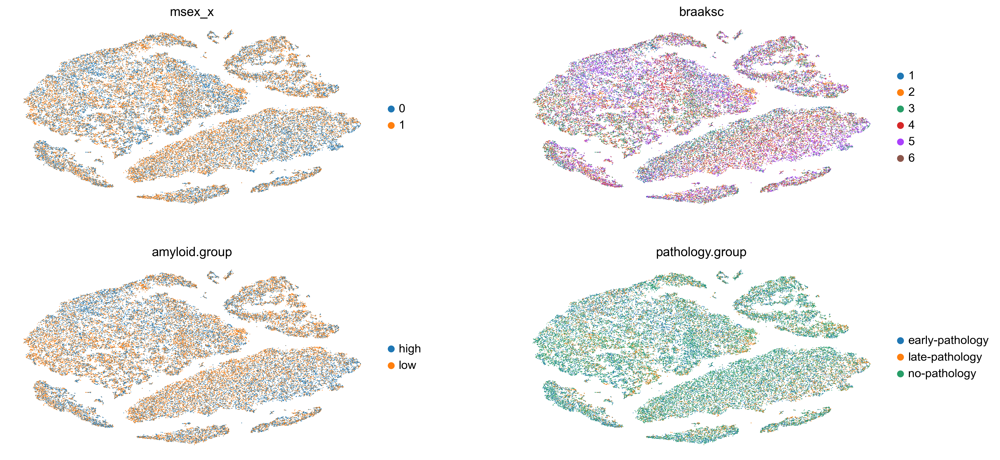

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:40)
Visualizing UMAP embedding...


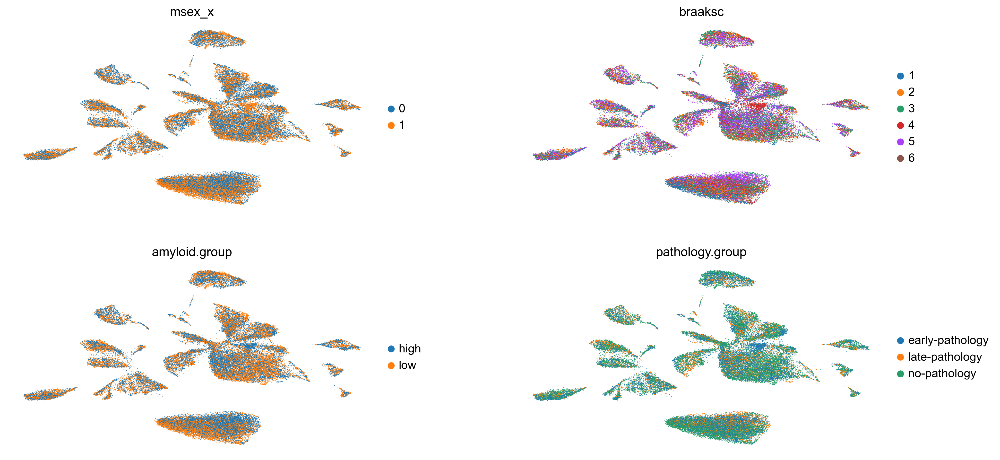

In [37]:
adata_filtered = dim_red(adata_filtered, use_hvgs=True, n_neighbors=30, n_pcs_neigh=50, n_pcs_tsne=10, use_fast_tsne=True,
                        tsne_colors=['msex_x', 'braaksc', 'amyloid.group', 'pathology.group'],
                        umap_colors=['msex_x', 'braaksc', 'amyloid.group', 'pathology.group'],
                        tsne_wspace=0.25, umap_wspace=0.25, viz_expl_ratio=True, viz_tsne=True, viz_umap=True)

We can see that both UMAP and TSNE plots yield good clustering representation of the the data in two-dimensions, but UMAP provides an embedding that's more faithful to the global connectivity of the manifold than tSNE, it better preserves trajectories since the connections between clusters are difficult to visually interpret in the TSNE, but more readily identified in UMAP. 

In summary, these visualizations delineate not technical effects in this data.

#### Louvain Clustering

In [38]:
def cluster(adata: AnnData,
            key_added: str='louvain_',
            resolutions: list=[0.5, 1.0], 
            viz_w_tsne: bool=True,
            viz_w_umap: bool=True,
            colors: list=['doublet_score'],
            tsne_wspace: float=0.25,
            umap_wspace: float=0.25,
            legend_fontsize: str='xx-small',
            figure_params: list=[]):

    sc.set_figure_params(**figure_params)

    for res in resolutions:
        # Perform clustering - using highly variable genes at each resolution
        sc.tl.louvain(adata_filtered, resolution=res, key_added=f'{key_added}{res}')
        colors.append(f'{key_added}{res}')

    if len(colors)%2 ==0:
        ncols = 2
    else:
        ncols = 3
        
    if viz_w_tsne:
        print('Visualizing tSNE embedding...')
        sc.pl.tsne(adata_filtered, color=colors, ncols=ncols, wspace=tsne_wspace, legend_fontsize=legend_fontsize)

    if viz_w_umap:
        print('Visualizing UMAP embedding...')       
        sc.pl.umap(adata_filtered, color=colors, ncols=ncols, wspace=umap_wspace, legend_fontsize=legend_fontsize)


    return adata

In [39]:
figure_params = {"scanpy": True, "dpi": rcParams['figure.dpi'], "dpi_save": 150, "frameon": False, 
                 "vector_friendly": True, "fontsize": 14, "figsize": (7, 3), "color_map": None,
                  "format": 'pdf', "facecolor": None, "transparent": False, "ipython_format": 'png2x'}

running Louvain clustering


/Users/temitopeleke/miniforge3/envs/mathys_reproduce_arm64/lib/python3.10/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


    using the "louvain" package of Traag (2017)
    finished: found 19 clusters and added
    'louvain_0.5', the cluster labels (adata.obs, categorical) (0:00:24)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 23 clusters and added
    'louvain_1.0', the cluster labels (adata.obs, categorical) (0:00:23)
Visualizing tSNE embedding...


/Users/temitopeleke/miniforge3/envs/mathys_reproduce_arm64/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:452: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  pl.colorbar(


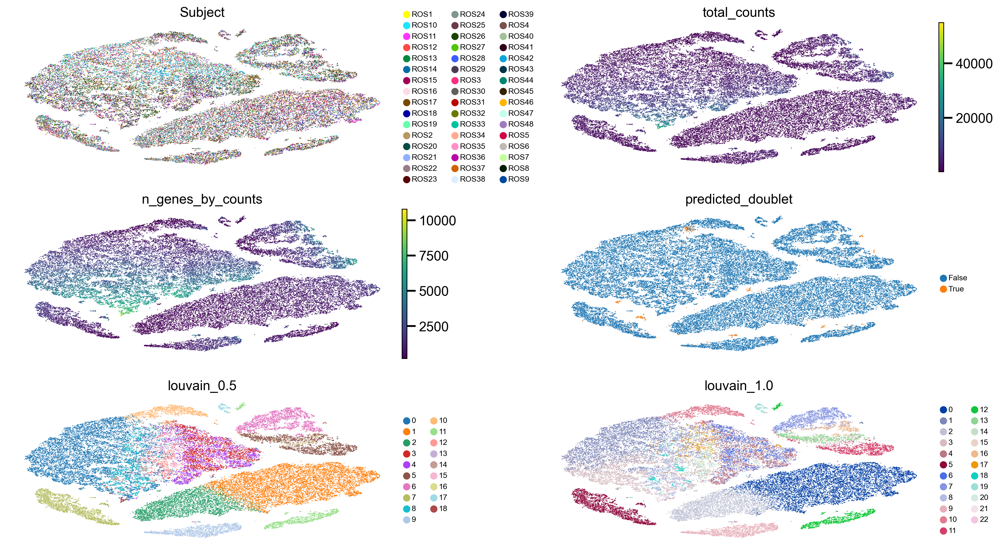

Visualizing UMAP embedding...


/Users/temitopeleke/miniforge3/envs/mathys_reproduce_arm64/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:452: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  pl.colorbar(


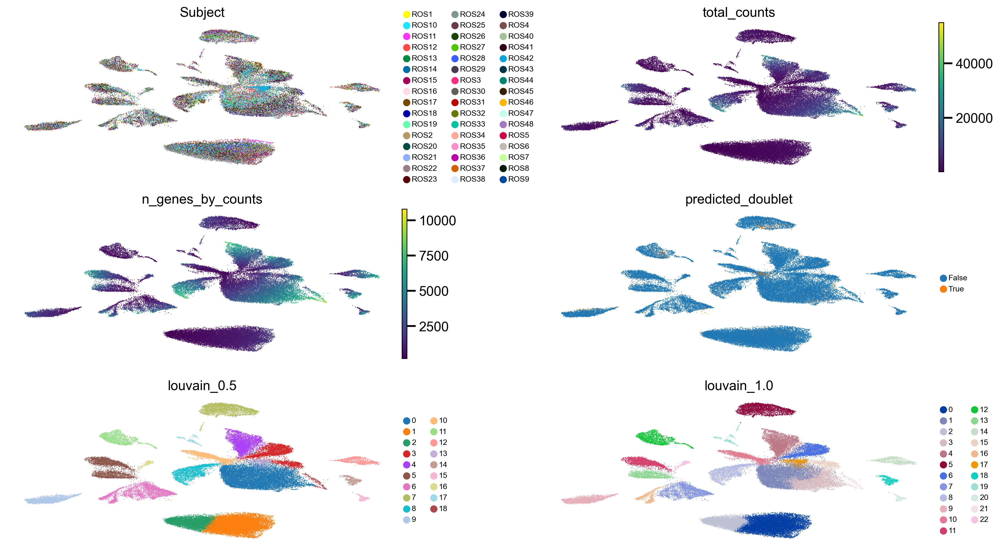

In [40]:
adata_filtered = cluster(adata_filtered, key_added='louvain_', resolutions=[0.5, 1.0], 
                        viz_w_tsne=True, viz_w_umap=True, colors=['Subject', 'total_counts', 'n_genes_by_counts', 'predicted_doublet'],
                        tsne_wspace=0.25, umap_wspace=0.25, legend_fontsize='xx-small', figure_params=figure_params)

#### Cluster distribution

In [41]:
adata_filtered.obs['louvain_0.5'].value_counts().median()

2704.0

We clustered the data at two resolutions `0.5, and 1.0`. Our analysis revealed the lower resolutin clustering at `r = 0.5` identified 20 clusters, consistent with the initial preclustering analysis in [**Hansruedi Mathys et. al.**](https://doi.org/10.1038/s41586-019-1195-2) that resulted in 20 pre-clusters. Here we found a `median` number of `2,704` cells `ranging` from `168 to 18680` cells, whereas [**Hansruedi Mathys et. al.**](https://doi.org/10.1038/s41586-019-1195-2) report a `2,990` cells, ranging from `413 to 15,900` cells, after excluding 2 pre-clusters of 360 and 791 cells that reflected low-quality cells (that is, cells that showed mixed cell-type markers; extreme complexity with many more genes expressed than other cells; either too many or too few reads; and, in one case, cells isolated almost exclusively from one individual). 

Indeed, from the above plots, the tSNE representation isolates a cluster of cells with unusually high doublet scores and number of detected genes with largely mixed cluster annotations, while we observe isolated clusters of extremely high and low detected genes mostly dominated by
cells in clusters 18 and 19 in the UMAP embedding. The authors do not report exclusion thresholds, so. in order appropriately exclude low-quality cells, we drop cells predicted as doublets using `predicted_doublet` in `.obs`. We note cells with `n_genes_by_counts` greater than the median `7,334` for `cluster 18 at resolution 0.5` and less than the median `545` for `cluster 19 at resolution 0.5`.

In [42]:
# filter out predicted doublets

adata_filtered = adata_filtered[adata_filtered.obs['predicted_doublet']!="True"]

#### Save Data

In [ ]:
obs_columns = list(adata_filtered.obs.columns)
adata_filtered.obs[obs_columns] = adata_filtered.obs[obs_columns].astype(str)

var_columns = list(adata_filtered.var.columns)
adata_filtered.var[var_columns] = adata_filtered.var[var_columns].astype(str)

In [ ]:
del adata_filtered.uns['scrublet']['doublet_neighbor_parents']

In [ ]:
adata_filtered.write_h5ad('../data/processed/adata_quality_control.h5ad', compression='gzip')